In [1]:
import matplotlib.pyplot as plt # https://matplotlib.org/stable/users/
%config InlineBackend.figure_format='retina'

import numpy as np

import pandas as pd
# https://pandas.pydata.org/docs/getting_started/intro_tutorials/
# https://pandas.pydata.org/docs/user_guide/

import seaborn as sns
# https://seaborn.pydata.org/tutorial.html

# Step 1: Read the data

In [2]:
df = pd.read_csv('data.csv')

In [3]:
df.head()

,geoid10,tax_mjoint,mjoint_mf,mjoint_ss,mjoint_ff,mjoint_mm,taxrate_ss,taxrate_ff,taxrate_mm,cns_tothh,...,ff_cns,ff_index,mm_tax,mm_cns,mm_index,ss_index,ss_index_weight,parade_weight,bars_weight,totindex
0,90069,2120,1689,431,61,370,203.301887,28.773585,174.528302,12551,...,1.847099,6.724415,29.583721,18.704533,48.288254,55.012669,39.429995,10,17.647059,67.077054
1,94114,5080,4036,1044,170,874,205.511811,33.464567,172.047244,16456,...,4.161579,9.834048,29.163165,19.415304,48.578469,58.412517,41.866815,0,20.000000,61.866815
2,10011,5790,5166,624,97,527,107.772021,16.753022,91.018998,29762,...,1.531029,4.370779,15.428332,10.932081,26.360413,30.731192,22.026394,10,5.882353,37.908747
3,10014,3510,3229,281,74,207,80.056980,21.082621,58.974359,18786,...,2.482293,6.055939,9.996551,5.943318,15.939869,21.995808,15.765361,10,11.764706,37.530067
4,94103,2660,2417,243,34,209,91.353383,12.781955,78.571429,12728,...,0.837431,3.004058,13.318386,4.961779,18.280165,21.284224,15.255337,10,10.588235,35.843573


In [4]:
df.dtypes

geoid10              int64
tax_mjoint           int64
mjoint_mf            int64
mjoint_ss            int64
mjoint_ff            int64
mjoint_mm            int64
taxrate_ss         float64
taxrate_ff         float64
taxrate_mm         float64
cns_tothh            int64
cns_upss             int64
cns_upff             int64
cns_upmm             int64
cns_ratess         float64
cns_rateff         float64
cns_ratemm         float64
paradeflag           int64
countbars            int64
ff_tax             float64
ff_cns             float64
ff_index           float64
mm_tax             float64
mm_cns             float64
mm_index           float64
ss_index           float64
ss_index_weight    float64
parade_weight        int64
bars_weight        float64
totindex           float64
dtype: object

In [5]:
#It has 2328 total rows
df.shape

(2328, 29)

In [6]:
# Check if there is any negative values in any cell in the dataframe, Theoretically there should not be any negative values. 
(df < 0).values.any()

False

In [7]:
df['geoid10'].nunique()

2328

In [8]:
# Change the geoid10 column type to string
df['geoid10'] = df['geoid10'].astype(str)

In [9]:
df.dtypes

geoid10             object
tax_mjoint           int64
mjoint_mf            int64
mjoint_ss            int64
mjoint_ff            int64
mjoint_mm            int64
taxrate_ss         float64
taxrate_ff         float64
taxrate_mm         float64
cns_tothh            int64
cns_upss             int64
cns_upff             int64
cns_upmm             int64
cns_ratess         float64
cns_rateff         float64
cns_ratemm         float64
paradeflag           int64
countbars            int64
ff_tax             float64
ff_cns             float64
ff_index           float64
mm_tax             float64
mm_cns             float64
mm_index           float64
ss_index           float64
ss_index_weight    float64
parade_weight        int64
bars_weight        float64
totindex           float64
dtype: object

# Step 2: Clean the data

In [10]:
#  Obtain a summary of the count of each geoid10 length under geoid10 column to see if they are all 5 digits
df.geoid10.str.len().value_counts().reset_index()

,geoid10,count
0,5,1965
1,4,363


In [11]:
# What are the rows that containts 4 digits for geoid10? 
fourdigitszip = df[df.geoid10.str.len() == 4]
fourdigitszip 

,geoid10,tax_mjoint,mjoint_mf,mjoint_ss,mjoint_ff,mjoint_mm,taxrate_ss,taxrate_ff,taxrate_mm,cns_tothh,...,ff_cns,ff_index,mm_tax,mm_cns,mm_index,ss_index,ss_index_weight,parade_weight,bars_weight,totindex
26,2116,2820,2691,129,9,120,45.744681,3.191489,42.553191,11460,...,0.790576,1.331555,7.213052,2.534493,9.747546,11.079100,7.940878,10,3.529412,21.470289
28,2108,870,853,17,3,14,19.540230,3.448276,16.091954,2114,...,0.000000,0.584506,2.727694,7.815126,10.542820,11.127326,7.975443,10,2.352941,20.328385
31,2118,2780,2488,292,33,259,105.035971,11.870504,93.165468,12500,...,0.682165,2.694295,15.792173,7.375906,23.168079,25.862374,18.536699,0,1.176471,19.713170
44,2130,4640,4242,398,246,152,85.775862,53.017241,32.758621,16070,...,4.178630,13.165409,5.552807,3.266628,8.819434,21.984843,15.757502,0,0.000000,15.757502
68,2131,4120,3911,209,161,48,50.728155,39.077670,11.650485,12092,...,4.231091,10.855019,1.974836,2.534247,4.509083,15.364102,11.012126,0,0.000000,11.012126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2191,8014,0,0,0,0,0,0.000000,0.000000,0.000000,238,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2199,8073,0,0,0,0,0,0.000000,0.000000,0.000000,130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2211,7608,0,0,0,0,0,0.000000,0.000000,0.000000,43,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2220,2203,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000


In [12]:
# Make a copy of fourdigitszip in case fourdigitszip needs to be used later
fivedigitszip = fourdigitszip.copy()

In [13]:
# Adding leading 0 to geoid10 column
fivedigitszip['geoid10'] = fivedigitszip['geoid10'].str.zfill(5)
fivedigitszip

,geoid10,tax_mjoint,mjoint_mf,mjoint_ss,mjoint_ff,mjoint_mm,taxrate_ss,taxrate_ff,taxrate_mm,cns_tothh,...,ff_cns,ff_index,mm_tax,mm_cns,mm_index,ss_index,ss_index_weight,parade_weight,bars_weight,totindex
26,02116,2820,2691,129,9,120,45.744681,3.191489,42.553191,11460,...,0.790576,1.331555,7.213052,2.534493,9.747546,11.079100,7.940878,10,3.529412,21.470289
28,02108,870,853,17,3,14,19.540230,3.448276,16.091954,2114,...,0.000000,0.584506,2.727694,7.815126,10.542820,11.127326,7.975443,10,2.352941,20.328385
31,02118,2780,2488,292,33,259,105.035971,11.870504,93.165468,12500,...,0.682165,2.694295,15.792173,7.375906,23.168079,25.862374,18.536699,0,1.176471,19.713170
44,02130,4640,4242,398,246,152,85.775862,53.017241,32.758621,16070,...,4.178630,13.165409,5.552807,3.266628,8.819434,21.984843,15.757502,0,0.000000,15.757502
68,02131,4120,3911,209,161,48,50.728155,39.077670,11.650485,12092,...,4.231091,10.855019,1.974836,2.534247,4.509083,15.364102,11.012126,0,0.000000,11.012126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2191,08014,0,0,0,0,0,0.000000,0.000000,0.000000,238,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2199,08073,0,0,0,0,0,0.000000,0.000000,0.000000,130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2211,07608,0,0,0,0,0,0.000000,0.000000,0.000000,43,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2220,02203,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000


In [14]:
# Drop all the rows in the df that have 4 digits zipcodes under column geoid10
df = df[df.geoid10.str.len() != 4]
df

,geoid10,tax_mjoint,mjoint_mf,mjoint_ss,mjoint_ff,mjoint_mm,taxrate_ss,taxrate_ff,taxrate_mm,cns_tothh,...,ff_cns,ff_index,mm_tax,mm_cns,mm_index,ss_index,ss_index_weight,parade_weight,bars_weight,totindex
0,90069,2120,1689,431,61,370,203.301887,28.773585,174.528302,12551,...,1.847099,6.724415,29.583721,18.704533,48.288254,55.012669,39.429995,10,17.647059,67.077054
1,94114,5080,4036,1044,170,874,205.511811,33.464567,172.047244,16456,...,4.161579,9.834048,29.163165,19.415304,48.578469,58.412517,41.866815,0,20.000000,61.866815
2,10011,5790,5166,624,97,527,107.772021,16.753022,91.018998,29762,...,1.531029,4.370779,15.428332,10.932081,26.360413,30.731192,22.026394,10,5.882353,37.908747
3,10014,3510,3229,281,74,207,80.056980,21.082621,58.974359,18786,...,2.482293,6.055939,9.996551,5.943318,15.939869,21.995808,15.765361,10,11.764706,37.530067
4,94103,2660,2417,243,34,209,91.353383,12.781955,78.571429,12728,...,0.837431,3.004058,13.318386,4.961779,18.280165,21.284224,15.255337,10,10.588235,35.843573
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2323,97208,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2324,98154,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2325,98158,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2326,98174,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000


In [15]:
# Concatenating fivedigitszip to the df so that new df has only 5 digit zipcodes for all the 2328 rows
df = pd.concat([df, fivedigitszip])
df

,geoid10,tax_mjoint,mjoint_mf,mjoint_ss,mjoint_ff,mjoint_mm,taxrate_ss,taxrate_ff,taxrate_mm,cns_tothh,...,ff_cns,ff_index,mm_tax,mm_cns,mm_index,ss_index,ss_index_weight,parade_weight,bars_weight,totindex
0,90069,2120,1689,431,61,370,203.301887,28.773585,174.528302,12551,...,1.847099,6.724415,29.583721,18.704533,48.288254,55.012669,39.429995,10,17.647059,67.077054
1,94114,5080,4036,1044,170,874,205.511811,33.464567,172.047244,16456,...,4.161579,9.834048,29.163165,19.415304,48.578469,58.412517,41.866815,0,20.000000,61.866815
2,10011,5790,5166,624,97,527,107.772021,16.753022,91.018998,29762,...,1.531029,4.370779,15.428332,10.932081,26.360413,30.731192,22.026394,10,5.882353,37.908747
3,10014,3510,3229,281,74,207,80.056980,21.082621,58.974359,18786,...,2.482293,6.055939,9.996551,5.943318,15.939869,21.995808,15.765361,10,11.764706,37.530067
4,94103,2660,2417,243,34,209,91.353383,12.781955,78.571429,12728,...,0.837431,3.004058,13.318386,4.961779,18.280165,21.284224,15.255337,10,10.588235,35.843573
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2191,08014,0,0,0,0,0,0.000000,0.000000,0.000000,238,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2199,08073,0,0,0,0,0,0.000000,0.000000,0.000000,130,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2211,07608,0,0,0,0,0,0.000000,0.000000,0.000000,43,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000
2220,02203,0,0,0,0,0,0.000000,0.000000,0.000000,0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000


# Step 3: Find which columns to focus on in the data

<Axes: >

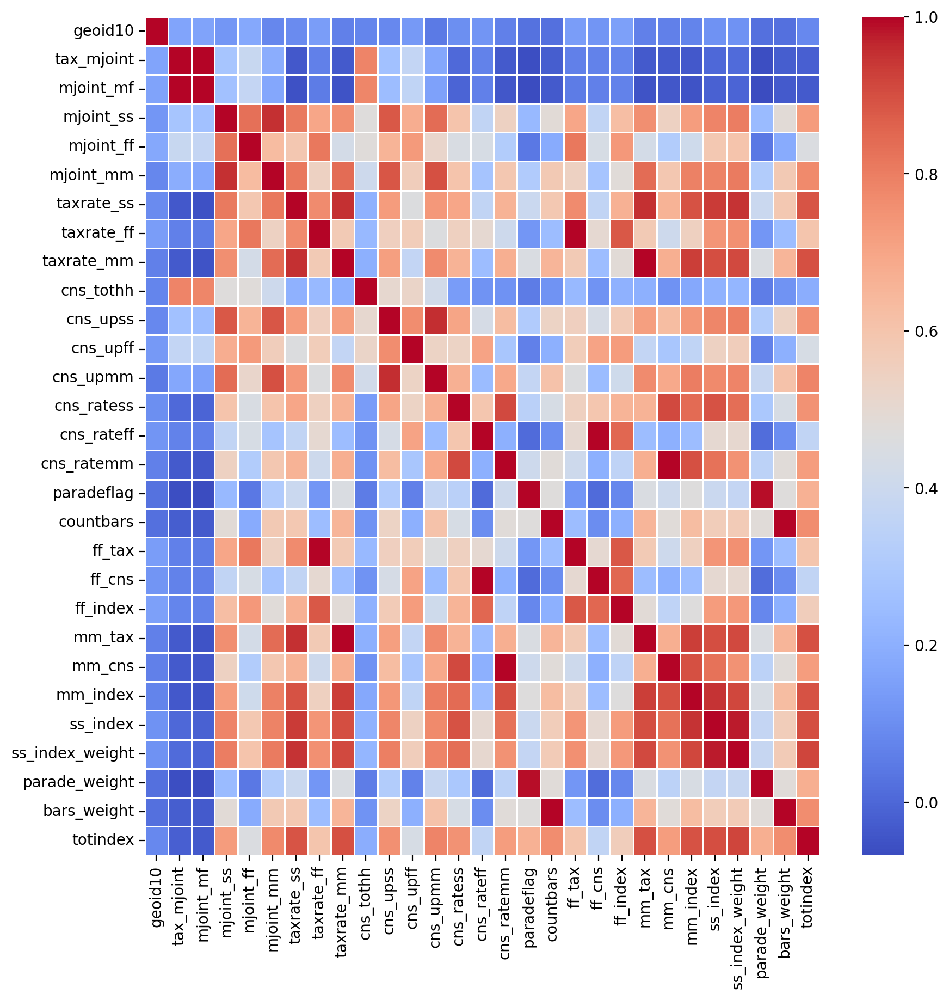

In [16]:
# use heatmap to show correlation
fig, ax = plt.subplots(figsize=(10,10))    
sns.heatmap(df.corr(), cmap='coolwarm', linecolor='white', linewidth=0.5, xticklabels=True, yticklabels=True, ax=ax)

In [17]:
sns.pairplot(df)

In [18]:
# Too many columns in the dataframe and lots columns are deriviated from others. I want to pick several columns that present the structure of the study to focus on. 
df_focus = df[['geoid10', 'tax_mjoint', 'mjoint_mm', 'taxrate_mm', 'mjoint_ff', 'taxrate_ff', 'cns_tothh', 'cns_upmm', 'cns_ratemm', 'cns_upff', 'cns_rateff', 'paradeflag', 'countbars', 'totindex']]
df_focus

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
2,10011,5790,527,91.018998,97,16.753022,29762,1221,41.025469,171,5.745582,1,5,37.908747
3,10014,3510,207,58.974359,74,21.082621,18786,419,22.303843,175,9.315448,1,10,37.530067
4,94103,2660,209,78.571429,34,12.781955,12728,237,18.620365,40,3.142678,1,9,35.843573
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2191,08014,0,0,0.000000,0,0.000000,238,0,0.000000,0,0.000000,0,0,0.000000
2199,08073,0,0,0.000000,0,0.000000,130,0,0.000000,0,0.000000,0,0,0.000000
2211,07608,0,0,0.000000,0,0.000000,43,0,0.000000,0,0.000000,0,0,0.000000
2220,02203,0,0,0.000000,0,0.000000,0,0,0.000000,0,0.000000,0,0,0.000000


# Step 4: Analyze the data

In [19]:
df_focus.nlargest(10, 'totindex')
# 90069-WEST HOLLYWOOD CA
# 94114-SAN FRANCISCO CA
# 10011-NEW YORK NY
# 10014-NEW YORK NY
# 94103-SAN FRANCISCO CA
# 70116-NEW ORLEANS LA
# 20009-WASHINGTON DC
# 98122-SEATTLE WA
# 30309-ATLANTA GA
# 90046-LOS ANGELES CA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
2,10011,5790,527,91.018998,97,16.753022,29762,1221,41.025469,171,5.745582,1,5,37.908747
3,10014,3510,207,58.974359,74,21.082621,18786,419,22.303843,175,9.315448,1,10,37.530067
4,94103,2660,209,78.571429,34,12.781955,12728,237,18.620365,40,3.142678,1,9,35.843573
5,70116,570,34,59.649123,8,14.035088,6235,167,26.784282,21,3.368083,1,9,35.299180
6,20009,4350,392,90.114943,60,13.793103,26682,751,28.146316,176,6.596207,1,5,35.141959
7,98122,3940,257,65.228426,131,33.248731,16673,410,24.590656,110,6.597493,0,12,32.038585
8,30309,2900,119,41.034483,16,5.517241,12896,436,33.808933,30,2.326303,1,8,31.968980
9,90046,4680,405,86.538462,71,15.170940,29069,847,29.137569,155,5.332141,1,2,31.293323


In [20]:
df_focus.nlargest(3, 'countbars')
# 94114-SAN FRANCISCO CA
# 90069-WEST HOLLYWOOD CA
# 98122-SEATTLE WA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
7,98122,3940,257,65.228426,131,33.248731,16673,410,24.590656,110,6.597493,0,12,32.038585


In [21]:
# For MM couples
df_focus.nlargest(3, 'taxrate_mm')
# 90069-WEST HOLLYWOOD CA
# 94114-SAN FRANCISCO CA
# 20005-WASHINGTON DC

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
10,20005,990,109,110.101010,7,7.070707,8351,144,17.243444,9,1.077715,1,3,31.264124


In [22]:
df_focus.nlargest(3, 'cns_ratemm')
# 94104-SAN FRANCISCO CA
# 94114-SAN FRANCISCO CA
# 90069-WEST HOLLYWOOD CA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
2179,94104,330,8,24.242424,3,9.090909,176,19,107.954545,0,0.000000,1,0,0.000000
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054


In [23]:
# For FF couples
df_focus.nlargest(3, 'taxrate_ff')
# 02130-JAMAICA PLAIN MA
# 94702-BERKELEY CA
# 94609-OAKLAND CA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
44,02130,4640,152,32.758621,246,53.017241,16070,197,12.258867,252,15.681394,0,0,15.757502
89,94702,2530,42,16.600791,116,45.849802,7581,43,5.672075,34,4.484896,0,0,9.527196
81,94609,2380,44,18.487395,100,42.016807,9794,61,6.228303,75,7.657750,0,0,10.002945


In [24]:
df_focus.nlargest(3, 'cns_rateff')
# 78742-AUSTIN TX
# 20762-ANDREWS AIR FORCE BASE MD
# 30317-ATLANTA GA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
2182,78742,0,0,0.000000,0,0.000000,273,0,0.000000,9,32.967033,0,0,0.000000
281,20762,640,0,0.000000,0,0.000000,897,0,0.000000,22,24.526198,0,0,4.684287
53,30317,1640,32,19.512195,47,28.658537,5087,92,18.085316,110,21.623747,0,0,13.436483


# Step 5: Visualize the data

## Based on above top taxrate_ff and cns_rateff, it shows that MM and FF couples do not really reside in the same areas.

## The rate itself may not print the whole picture since the denominator matters. Below I am looking at the rate and its denominator together to pick up the best zipcode.

## MM Couples

### MM Couples - taxrate_mm

In [25]:
# Get the rows that contain the top 10 taxrate_mm
df_focus_taxrate_mm_top = df_focus.nlargest(10, 'taxrate_mm')
df_focus_taxrate_mm_top

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
10,20005,990,109,110.101010,7,7.070707,8351,144,17.243444,9,1.077715,1,3,31.264124
31,02118,2780,259,93.165468,33,11.870504,12500,346,27.680000,32,2.560000,0,1,19.713170
2,10011,5790,527,91.018998,97,16.753022,29762,1221,41.025469,171,5.745582,1,5,37.908747
6,20009,4350,392,90.114943,60,13.793103,26682,751,28.146316,176,6.596207,1,5,35.141959
9,90046,4680,405,86.538462,71,15.170940,29069,847,29.137569,155,5.332141,1,2,31.293323
4,94103,2660,209,78.571429,34,12.781955,12728,237,18.620365,40,3.142678,1,9,35.843573
30,20001,3320,253,76.204819,37,11.144578,17917,361,20.148462,74,4.130156,0,4,19.955217
21,94102,2670,200,74.906367,30,11.235955,16463,201,12.209196,28,1.700784,1,1,24.298835


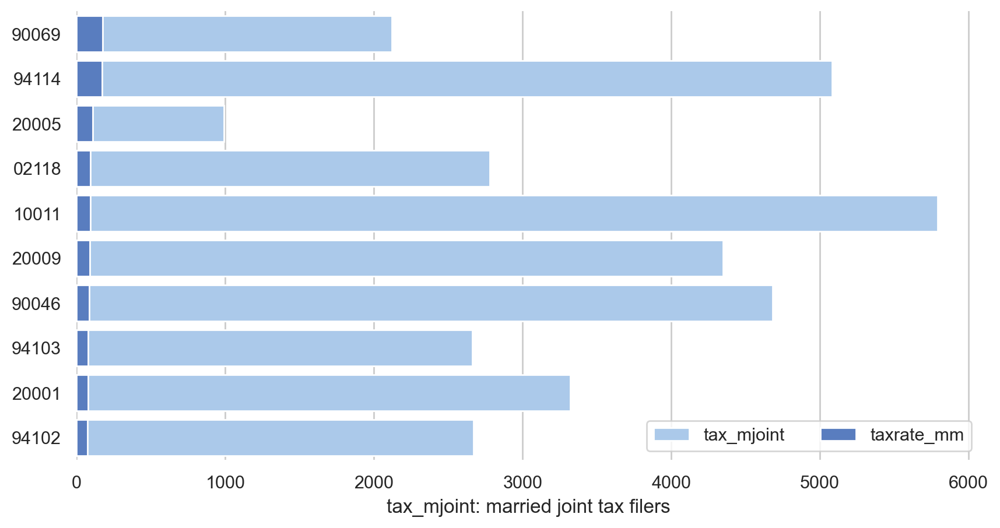

In [26]:
# Draw the stack bar that shows rate and total(denominator)
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="whitegrid")

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(10, 5))

# Plot the tax_mjoint
sns.set_color_codes("pastel")
sns.barplot(x="tax_mjoint", y="geoid10", data=df_focus_taxrate_mm_top,
            label="tax_mjoint", color="b")

# Plot the taxrate_mm
sns.set_color_codes("muted")
sns.barplot(x="taxrate_mm", y="geoid10", data=df_focus_taxrate_mm_top,
            label="taxrate_mm", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="tax_mjoint: married joint tax filers")
sns.despine(left=True, bottom=True)

# I would pick 
# 90069-WEST HOLLYWOOD CA 
# 20005-WASHINGTON DC

### MM Couples - cns_ratemm

In [27]:
# Get the rows that contain the top 10 cns_ratemm
df_focus_cns_ratemm_top = df_focus.nlargest(10, 'cns_ratemm')
df_focus_cns_ratemm_top

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
2179,94104,330,8,24.242424,3,9.090909,176,19,107.954545,0,0.000000,1,0,0.000000
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
56,10162,320,0,0.000000,0,0.000000,671,46,68.554396,0,0.000000,0,0,13.093284
2180,07311,0,0,0.000000,0,0.000000,191,13,68.062827,0,0.000000,0,0,0.000000
17,94105,1520,72,47.368421,12,7.894737,3778,161,42.615140,0,0.000000,1,0,24.853197
2,10011,5790,527,91.018998,97,16.753022,29762,1221,41.025469,171,5.745582,1,5,37.908747
15,20036,470,22,46.808511,6,12.765957,3828,141,36.833856,23,6.008359,1,1,26.596831
27,94131,5080,336,66.141732,119,23.425197,13254,479,36.140033,196,14.787989,0,0,20.608549
59,20037,900,31,34.444444,3,3.333333,7088,255,35.976298,0,0.000000,0,1,12.637358


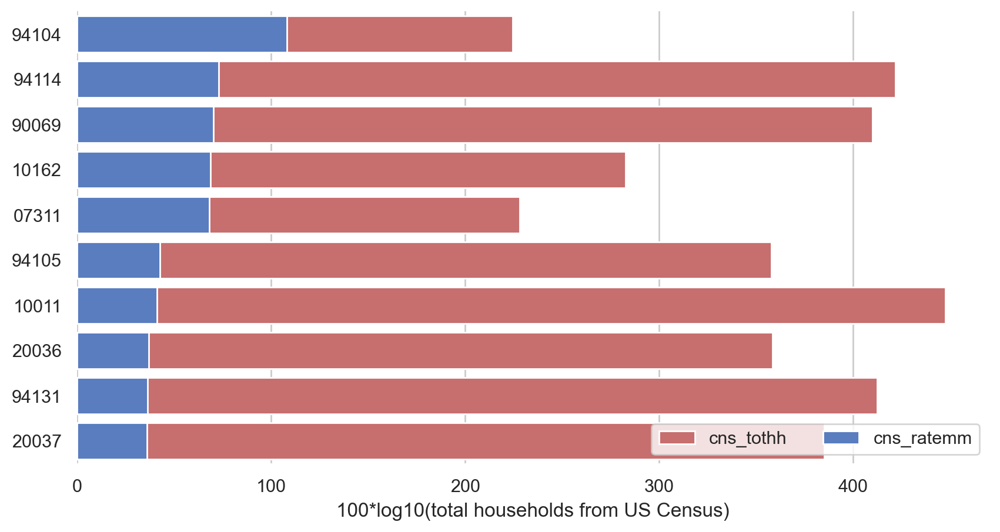

In [28]:
# Draw the stack bar that shows rate and total(denominator)

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(10, 5))

# Plot the tax_mjoint
# sns.set_color_codes("pastel")
sns.barplot(x=100*np.log10(df_focus_cns_ratemm_top['cns_tothh']), y="geoid10", data=df_focus_cns_ratemm_top,
            label="cns_tothh", color="r")

# Plot the taxrate_mm
sns.set_color_codes("muted")
sns.barplot(x="cns_ratemm", y="geoid10", data=df_focus_cns_ratemm_top,
            label="cns_ratemm", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="100*log10(total households from US Census)")
sns.despine(left=True, bottom=True)

# I would pick 
# 94104-SAN FRANCISCO CA

## FF Couples

### FF Couples - taxrate_ff

In [29]:
# Get the rows that contain the top 10 taxrate_ff
df_focus_taxrate_ff_top = df_focus.nlargest(10, 'taxrate_ff')
df_focus_taxrate_ff_top

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
44,02130,4640,152,32.758621,246,53.017241,16070,197,12.258867,252,15.681394,0,0,15.757502
89,94702,2530,42,16.600791,116,45.849802,7581,43,5.672075,34,4.484896,0,0,9.527196
81,94609,2380,44,18.487395,100,42.016807,9794,61,6.228303,75,7.657750,0,0,10.002945
68,02131,4120,48,11.650485,161,39.077670,12092,115,9.510420,192,15.878267,0,0,11.012126
76,94602,5010,77,15.369261,193,38.522954,11930,95,7.963118,133,11.148365,0,0,10.197647
70,94619,3930,81,20.610687,147,37.404580,8916,32,3.589053,144,16.150740,0,0,10.818570
40,98144,4260,208,48.826291,151,35.446009,12303,136,11.054214,198,16.093636,0,1,16.599957
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
97,19119,3360,26,7.738095,112,33.333333,12056,49,4.064366,185,15.345056,0,0,8.696916
7,98122,3940,257,65.228426,131,33.248731,16673,410,24.590656,110,6.597493,0,12,32.038585


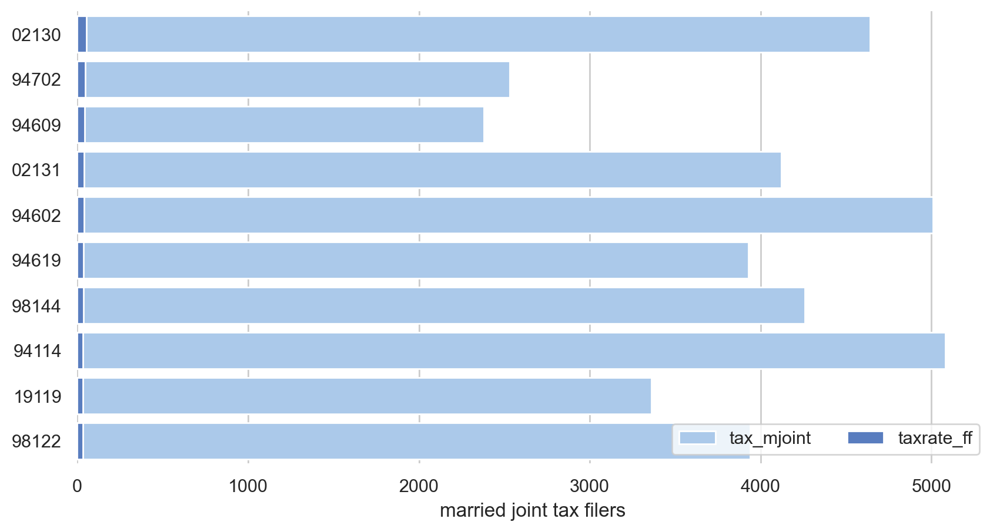

In [30]:
# Draw the stack bar that shows rate and total(denominator)

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(10, 5))

# Plot the tax_mjoint
sns.set_color_codes("pastel")
sns.barplot(x="tax_mjoint", y="geoid10", data=df_focus_taxrate_ff_top,
            label="tax_mjoint", color="b")

# Plot the taxrate_ff
sns.set_color_codes("muted")
sns.barplot(x="taxrate_ff", y="geoid10", data=df_focus_taxrate_ff_top,
            label="taxrate_ff", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="married joint tax filers")
sns.despine(left=True, bottom=True)

# I would pick
# 94702-BERKELEY CA
# 94609-OAKLAND CA

### FF Couples - cns_rateff

In [31]:
# Get the rows that contain the top 10 cns_rateff
df_focus_cns_rateff_top = df_focus.nlargest(10, 'cns_rateff')
df_focus_cns_rateff_top

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
2182,78742,0,0,0.000000,0,0.000000,273,0,0.000000,9,32.967033,0,0,0.000000
281,20762,640,0,0.000000,0,0.000000,897,0,0.000000,22,24.526198,0,0,4.684287
53,30317,1640,32,19.512195,47,28.658537,5087,92,18.085316,110,21.623747,0,0,13.436483
243,78669,2570,5,1.945525,17,6.614786,3620,6,1.657459,74,20.441989,0,0,5.260816
364,77562,1950,0,0.000000,0,0.000000,3573,0,0.000000,73,20.431010,0,0,3.902143
179,02464,610,3,4.918033,13,21.311475,1205,0,0.000000,21,17.427386,0,0,6.515176
142,02458,2450,17,6.938776,40,16.326531,4920,25,5.081301,84,17.073171,0,0,7.057878
172,20722,650,3,4.615385,15,23.076923,1778,0,0.000000,30,16.872891,0,0,6.586992
182,90041,4170,36,8.633094,28,6.714628,9591,72,7.507038,160,16.682306,0,0,6.484591
468,60480,1200,0,0.000000,0,0.000000,2125,0,0.000000,35,16.470588,0,0,3.145737


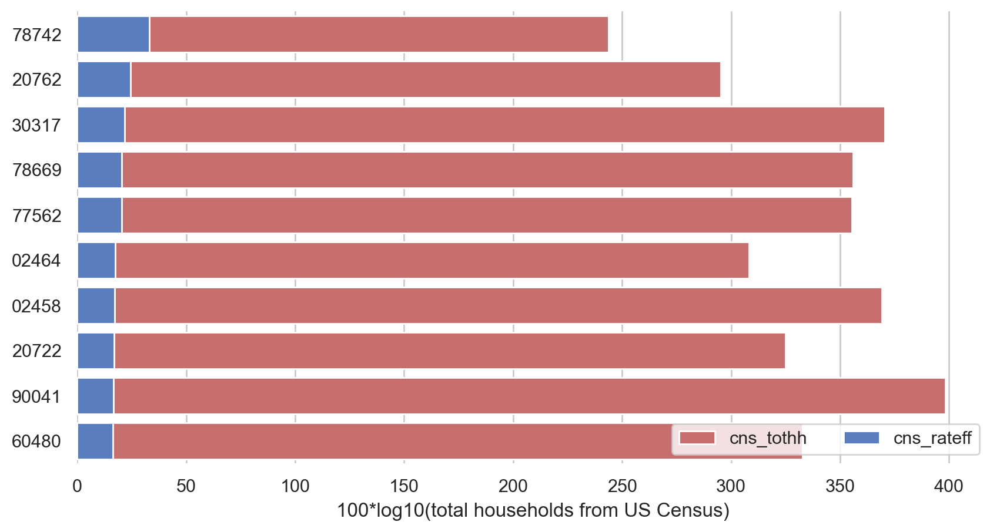

In [32]:
# Draw the stack bar that shows rate and total(denominator)

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(10, 5))

# Plot the tax_mjoint
# sns.set_color_codes("pastel")
sns.barplot(x=100*np.log10(df_focus_cns_rateff_top['cns_tothh']), y="geoid10", data=df_focus_cns_rateff_top,
            label="cns_tothh", color="r")

# Plot the taxrate_ff
sns.set_color_codes("muted")
sns.barplot(x="cns_rateff", y="geoid10", data=df_focus_cns_rateff_top,
            label="cns_rateff", color="b")

# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(ylabel="",
       xlabel="100*log10(total households from US Census)")
sns.despine(left=True, bottom=True)

# I would pick
# 78742-AUSTIN TX

# Step 6: Find correlations for my interested column

## Which other columns have good linear regression with taxrate_mm? 

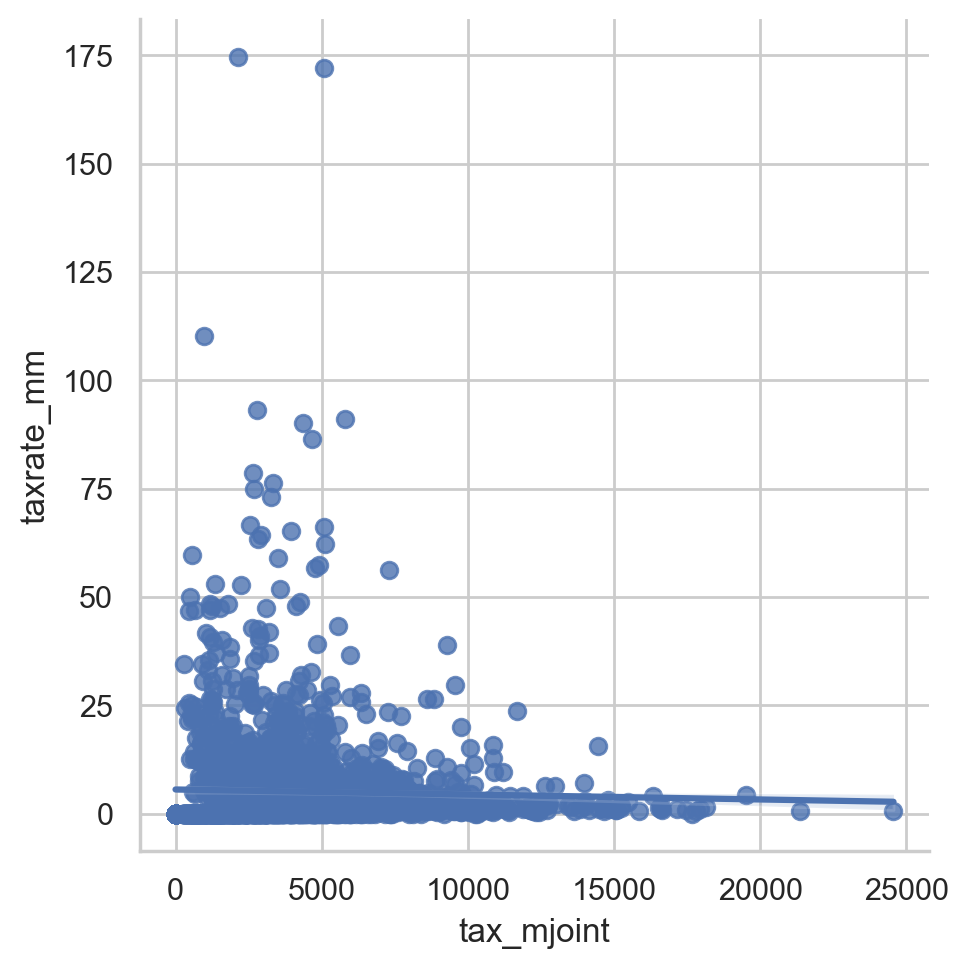

In [33]:
# Are the top tax_mjoint zipcode areas also ranked high for taxrate_mm? 
sns.lmplot(x='tax_mjoint',y='taxrate_mm',data=df_focus,palette='coolwarm')

In [34]:
# What are the rows that tax_mjoint < 10000 but taxrate_mm >150
df_focus[(df_focus['tax_mjoint'] < 10000) & (df_focus['taxrate_mm'] > 150)]

# Answer is 
# 90069-WEST HOLLYWOOD CA
# 94114-SAN FRANCISCO CA

# Lined up with above stack bar

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815


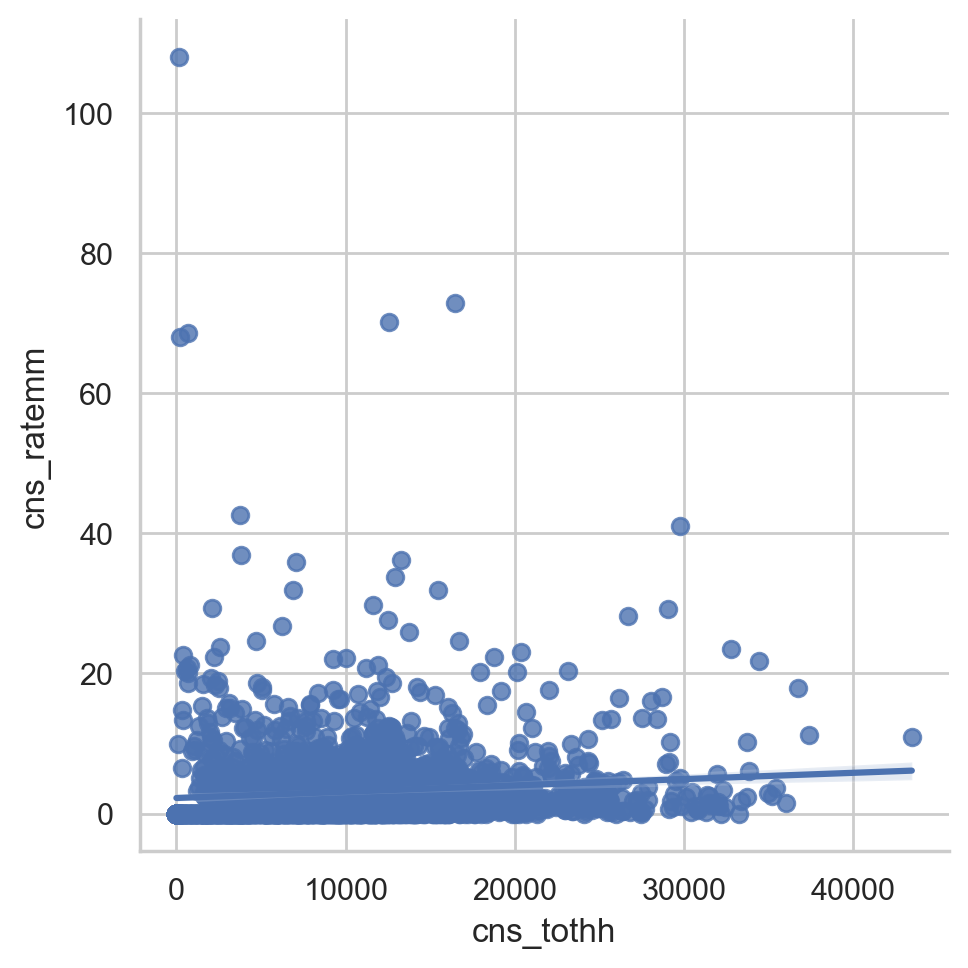

In [35]:
# Are the top cns_tothh zipcode areas also ranked high for cns_ratemm? 
sns.lmplot(x='cns_tothh',y='cns_ratemm',data=df_focus,palette='coolwarm')

In [36]:
# What are the rows that cns_tothh < 10000 but cns_ratemm >60
df_focus[(df_focus['cns_tothh'] < 10000) & (df_focus['cns_ratemm'] > 60)]

# Answer is 
# 10162-NEW YORK NY
# 94104-SAN FRANCISCO CA
# 07311-JERSEY CITY NJ

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
56,10162,320,0,0.000000,0,0.000000,671,46,68.554396,0,0.0,0,0,13.093284
2179,94104,330,8,24.242424,3,9.090909,176,19,107.954545,0,0.0,1,0,0.000000
2180,07311,0,0,0.000000,0,0.000000,191,13,68.062827,0,0.0,0,0,0.000000


## Which other columns have good linear regression with taxrate_ff? 

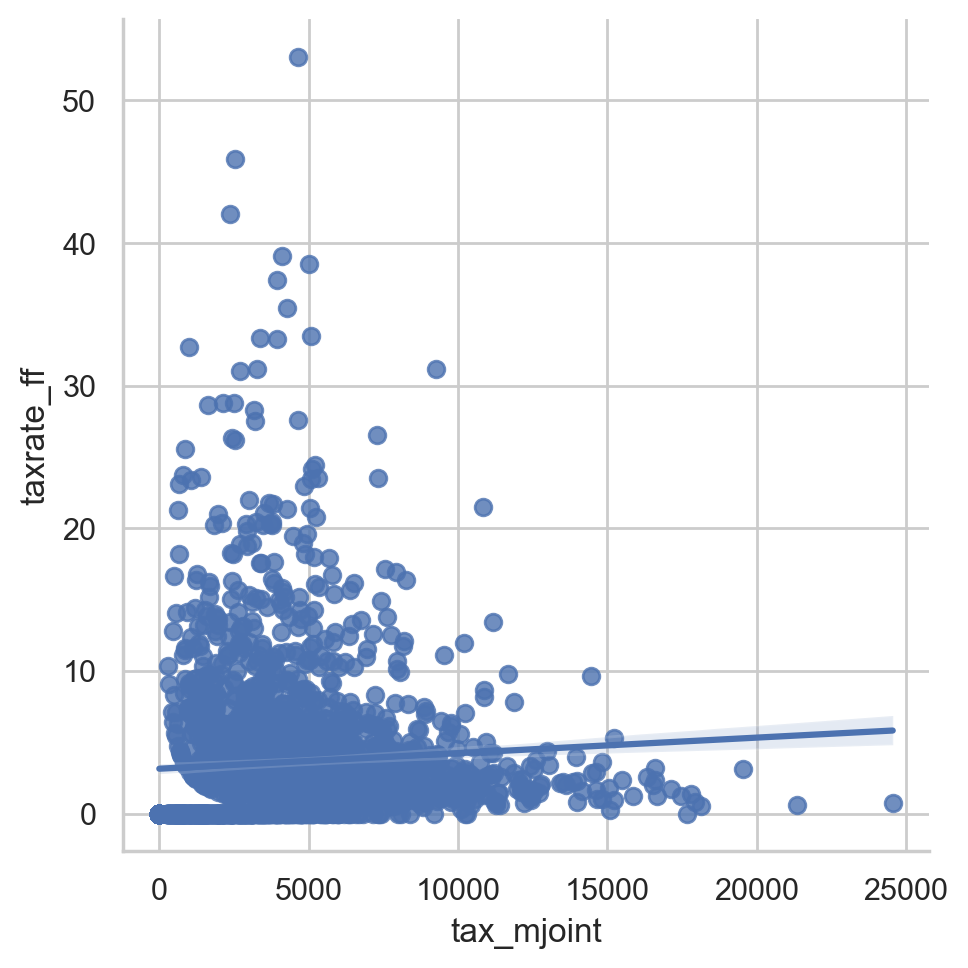

In [37]:
# Are the top Tax_Mjoint zipcode areas also ranked high for taxrate_ff? 
sns.lmplot(x='tax_mjoint',y='taxrate_ff',data=df_focus,palette='coolwarm')

In [38]:
# What are the rows that tax_mjoint < 10000 but taxrate_ff > 40
df_focus[(df_focus['tax_mjoint'] < 10000) & (df_focus['taxrate_ff'] > 40)]

# Answer is 
# 94609-OAKLAND CA
# 94702-BERKELEY CA
# 02130-JAMAICA PLAIN MA

# Lined up with above stack bar

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
81,94609,2380,44,18.487395,100,42.016807,9794,61,6.228303,75,7.657750,0,0,10.002945
89,94702,2530,42,16.600791,116,45.849802,7581,43,5.672075,34,4.484896,0,0,9.527196
44,02130,4640,152,32.758621,246,53.017241,16070,197,12.258867,252,15.681394,0,0,15.757502


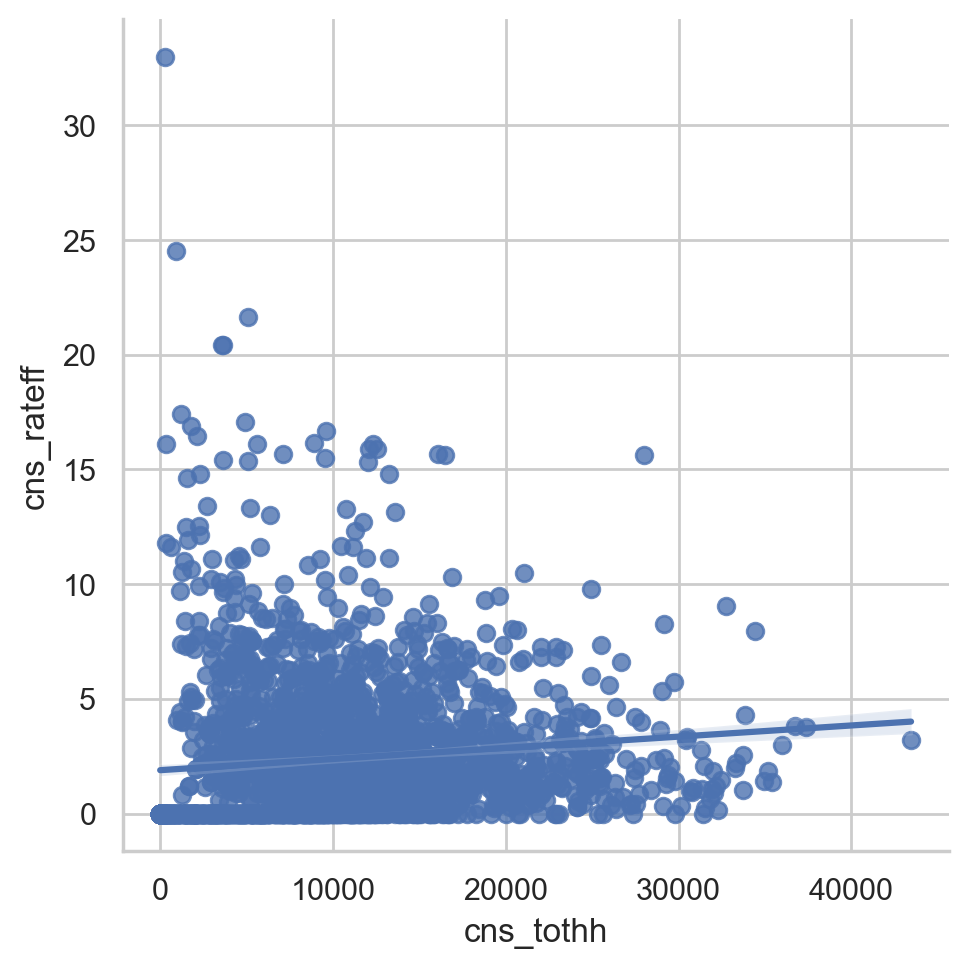

In [39]:
# Are the top cns_tothh zipcode areas also ranked high for cns_rateff? 
sns.lmplot(x='cns_tothh',y='cns_rateff',data=df_focus,palette='coolwarm')

In [40]:
# What are the rows that cns_tothh but cns_rateff >60
df_focus[(df_focus['cns_tothh'] < 10000) & (df_focus['cns_rateff'] > 20)]

# Answer is 
# 30317-ATLANTA GA
# 78669-SPICEWOOD TX surprising!
# 20762-ANDREWS AIR FORCE BASE MD
# 77562-HIGHLANDS TX
# 78742-AUSTIN TX

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
53,30317,1640,32,19.512195,47,28.658537,5087,92,18.085316,110,21.623747,0,0,13.436483
243,78669,2570,5,1.945525,17,6.614786,3620,6,1.657459,74,20.441989,0,0,5.260816
281,20762,640,0,0.000000,0,0.000000,897,0,0.000000,22,24.526198,0,0,4.684287
364,77562,1950,0,0.000000,0,0.000000,3573,0,0.000000,73,20.431010,0,0,3.902143
2182,78742,0,0,0.000000,0,0.000000,273,0,0.000000,9,32.967033,0,0,0.000000


In [41]:
df_focus.nlargest(10, 'totindex')
# 90069-WEST HOLLYWOOD CA
# 94114-SAN FRANCISCO CA
# 10011-NEW YORK NY
# 10014-NEW YORK NY
# 94103-SAN FRANCISCO CA
# 70116-NEW ORLEANS LA
# 20009-WASHINGTON DC
# 98122-SEATTLE WA
# 30309-ATLANTA GA
# 90046-LOS ANGELES CA

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.193610,87,6.931719,1,15,67.077054
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815
2,10011,5790,527,91.018998,97,16.753022,29762,1221,41.025469,171,5.745582,1,5,37.908747
3,10014,3510,207,58.974359,74,21.082621,18786,419,22.303843,175,9.315448,1,10,37.530067
4,94103,2660,209,78.571429,34,12.781955,12728,237,18.620365,40,3.142678,1,9,35.843573
5,70116,570,34,59.649123,8,14.035088,6235,167,26.784282,21,3.368083,1,9,35.299180
6,20009,4350,392,90.114943,60,13.793103,26682,751,28.146316,176,6.596207,1,5,35.141959
7,98122,3940,257,65.228426,131,33.248731,16673,410,24.590656,110,6.597493,0,12,32.038585
8,30309,2900,119,41.034483,16,5.517241,12896,436,33.808933,30,2.326303,1,8,31.968980
9,90046,4680,405,86.538462,71,15.170940,29069,847,29.137569,155,5.332141,1,2,31.293323


C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\4114247791.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')


<Axes: xlabel='paradeflag', ylabel='totindex'>

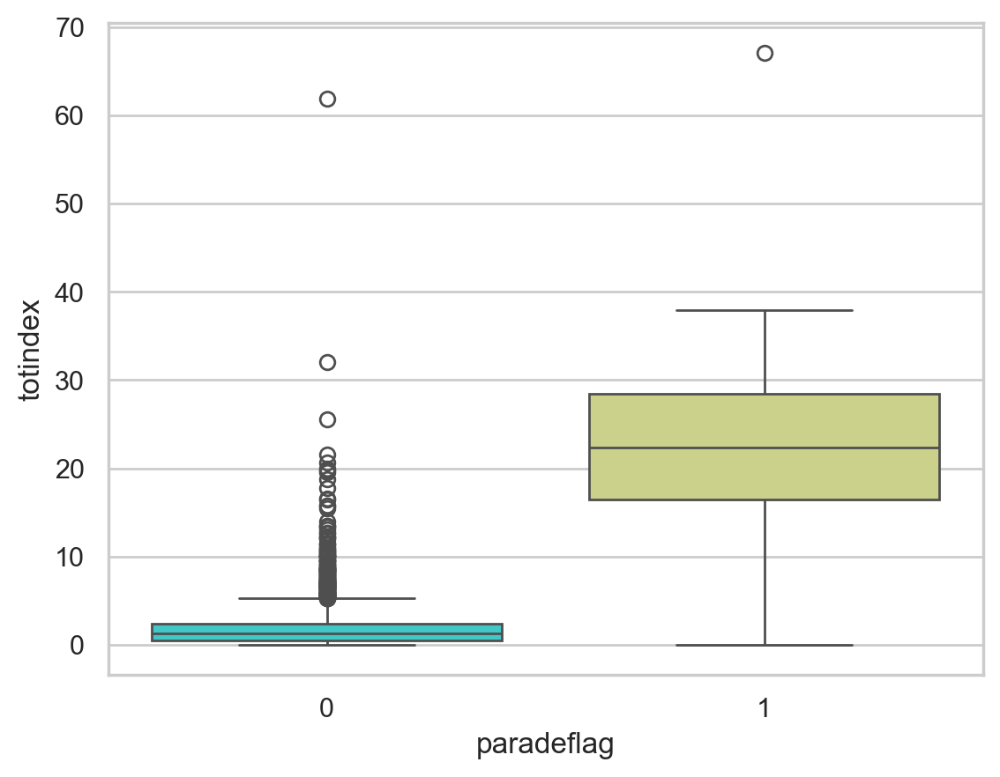

In [42]:
# Distribution of totindex based on if the pride parade goes through the zipcode
sns.boxplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')

C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\2070881786.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')


<Axes: xlabel='paradeflag', ylabel='totindex'>

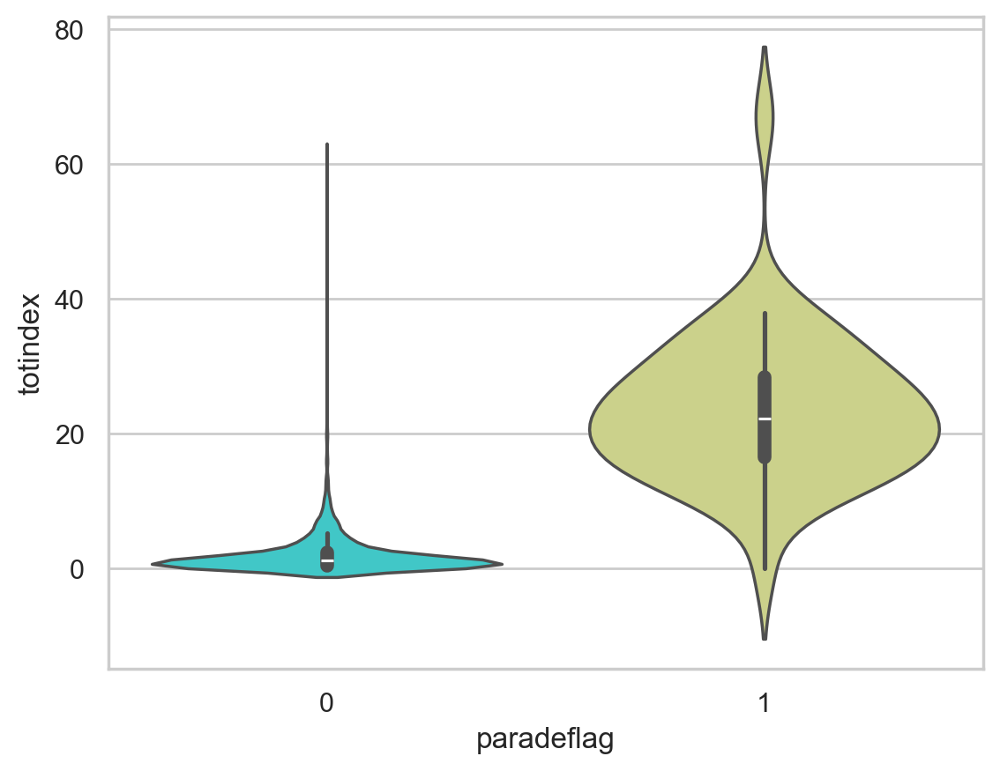

In [43]:
# the violin plot features a kernel density estimation of the underlying distribution! more info
sns.violinplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')

C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\1808079040.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow', jitter=True)


<Axes: xlabel='paradeflag', ylabel='totindex'>

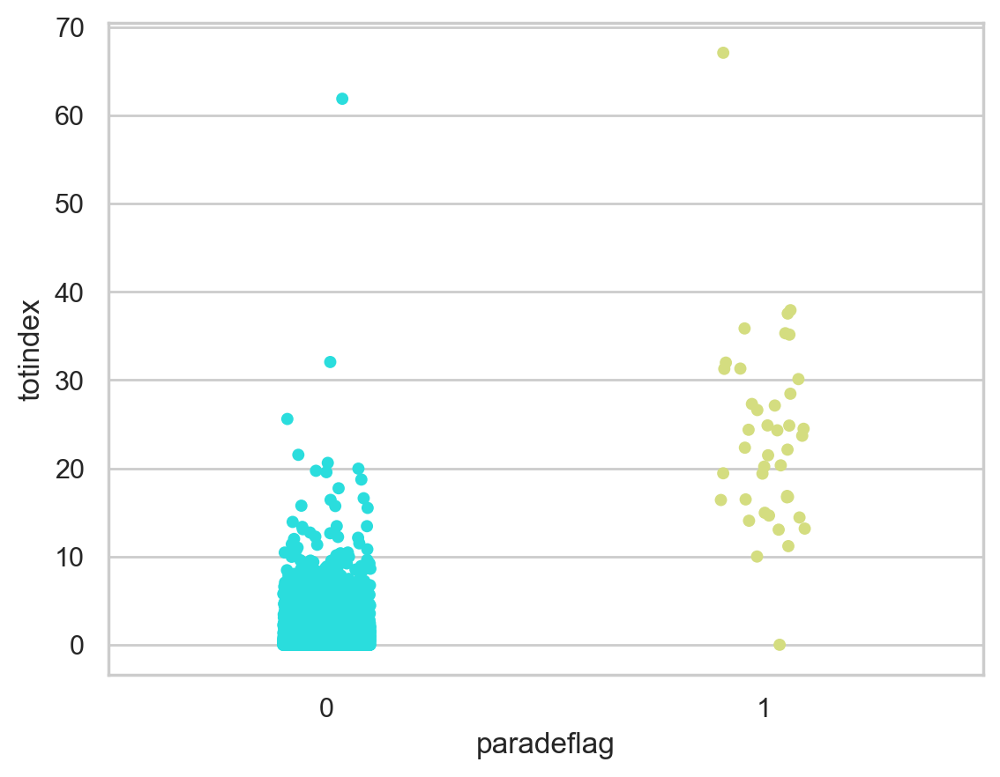

In [44]:
# jitter helps to see density better
sns.stripplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow', jitter=True)

C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\categorical.py:3370: UserWarning: 82.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<Axes: xlabel='paradeflag', ylabel='totindex'>

C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\categorical.py:3370: UserWarning: 88.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


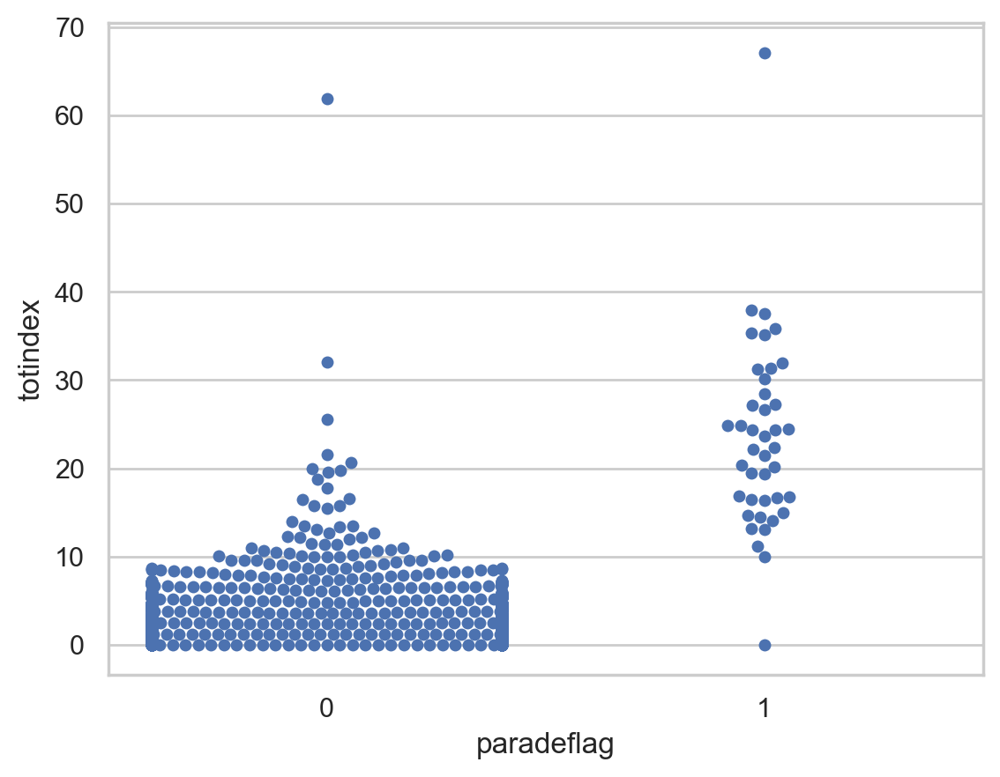

In [45]:
# combine striplot and violinplot
# points do not overlap
sns.swarmplot(x="paradeflag", y="totindex", data=df_focus)

C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\2820365621.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')
C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\categorical.py:3370: UserWarning: 90.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<Axes: xlabel='paradeflag', ylabel='totindex'>

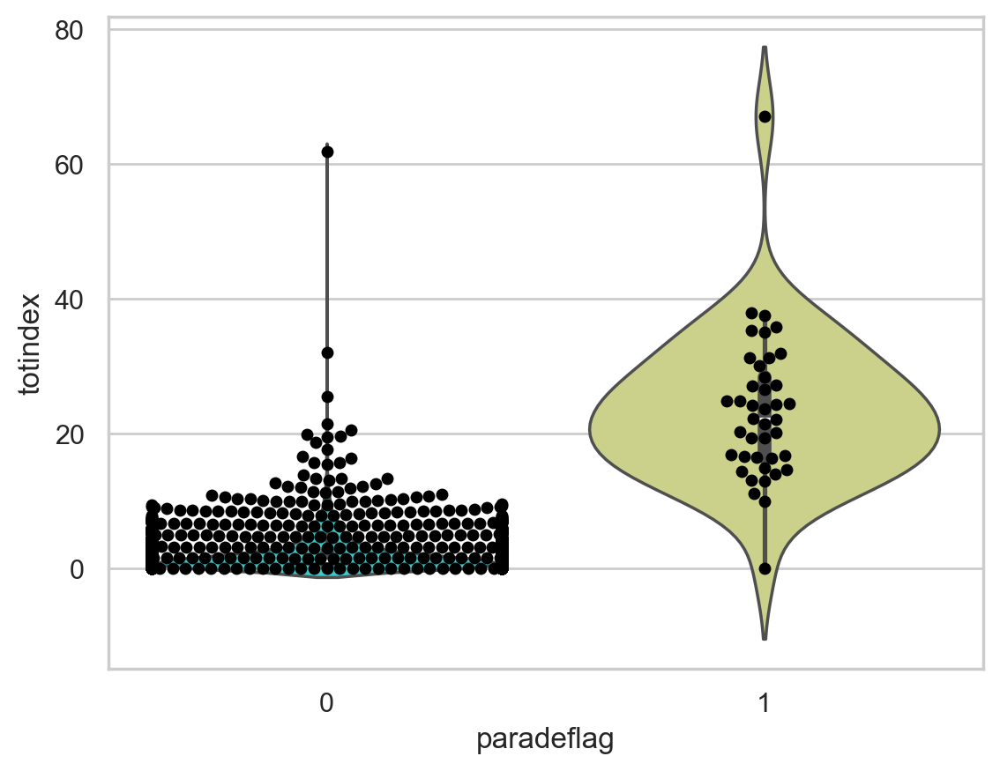

In [46]:
# Combining Categorical Plots
sns.violinplot(x="paradeflag", y="totindex", data=df_focus, palette='rainbow')
sns.swarmplot(x="paradeflag", y="totindex", data=df_focus, color='black')

In [47]:
df_focus[(df_focus['paradeflag'] == 0) & (df_focus['totindex'] > 60)]

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
1,94114,5080,874,172.047244,170,33.464567,16456,1199,72.860963,257,15.617404,0,17,61.866815


In [48]:
df_focus[(df_focus['paradeflag'] == 1) & (df_focus['totindex'] > 60)]

,geoid10,tax_mjoint,mjoint_mm,taxrate_mm,mjoint_ff,taxrate_ff,cns_tothh,cns_upmm,cns_ratemm,cns_upff,cns_rateff,paradeflag,countbars,totindex
0,90069,2120,370,174.528302,61,28.773585,12551,881,70.19361,87,6.931719,1,15,67.077054


# Step 7: Initial look at the correlations

In [49]:
corr = df_focus.corr()
type(corr)

pandas.core.frame.DataFrame

In [50]:
corr[['cns_ratemm']].sort_values(by=['cns_ratemm'])

,cns_ratemm
tax_mjoint,-0.031871
geoid10,0.063320
cns_tothh,0.109584
cns_rateff,0.202493
cns_upff,0.285508
mjoint_ff,0.316029
paradeflag,0.404067
taxrate_ff,0.407464
countbars,0.482626
mjoint_mm,0.590491


In [51]:
corr[['taxrate_mm']].sort_values(by=['taxrate_mm'])

,taxrate_mm
tax_mjoint,-0.032716
geoid10,0.064971
cns_tothh,0.202179
cns_rateff,0.248544
cns_upff,0.368448
mjoint_ff,0.426547
paradeflag,0.450557
taxrate_ff,0.576470
countbars,0.650955
cns_ratemm,0.674153


C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1886: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(self.x, **orient_kw_x, **kwargs)
C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1892: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(self.y, **orient_kw

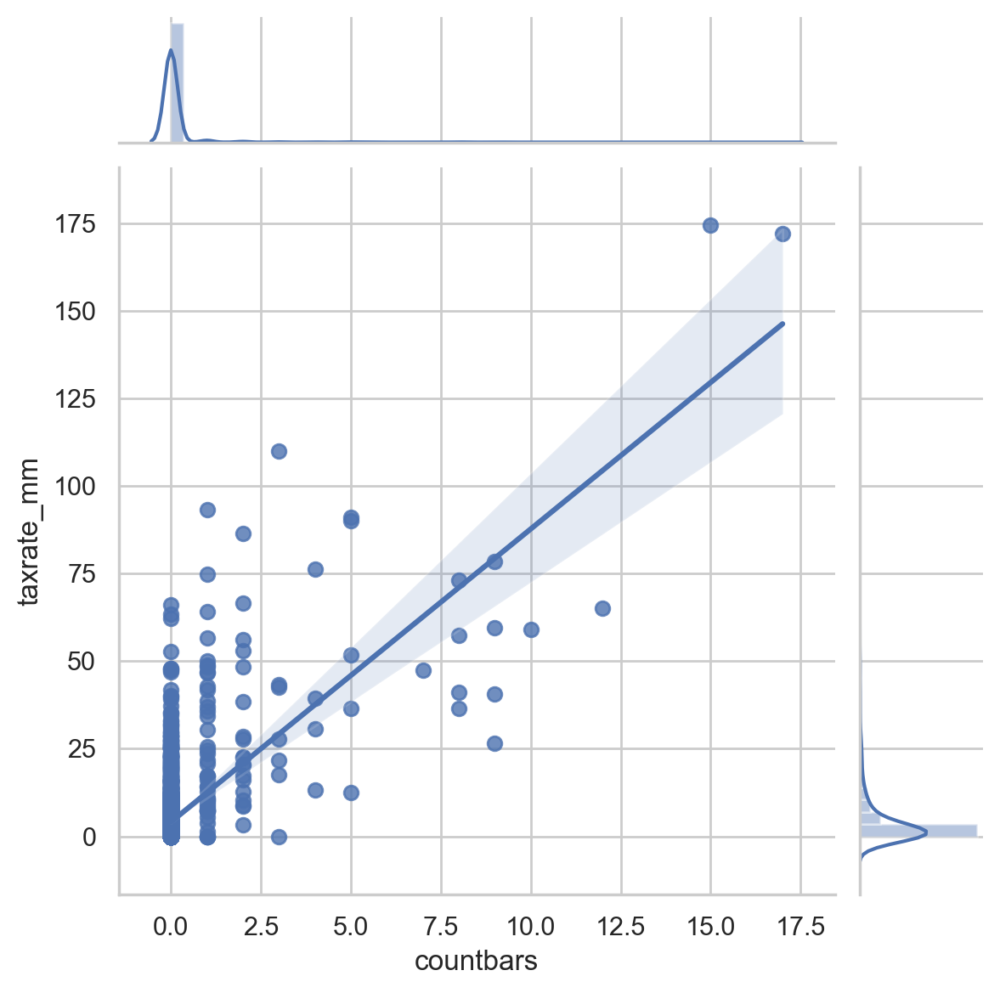

In [52]:
g = sns.JointGrid(x="countbars", y="taxrate_mm", data=df_focus)
g = g.plot(sns.regplot, sns.distplot)

C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1886: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(self.x, **orient_kw_x, **kwargs)
C:\Users\gongl1\AppData\Local\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1892: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(self.y, **orient_kw

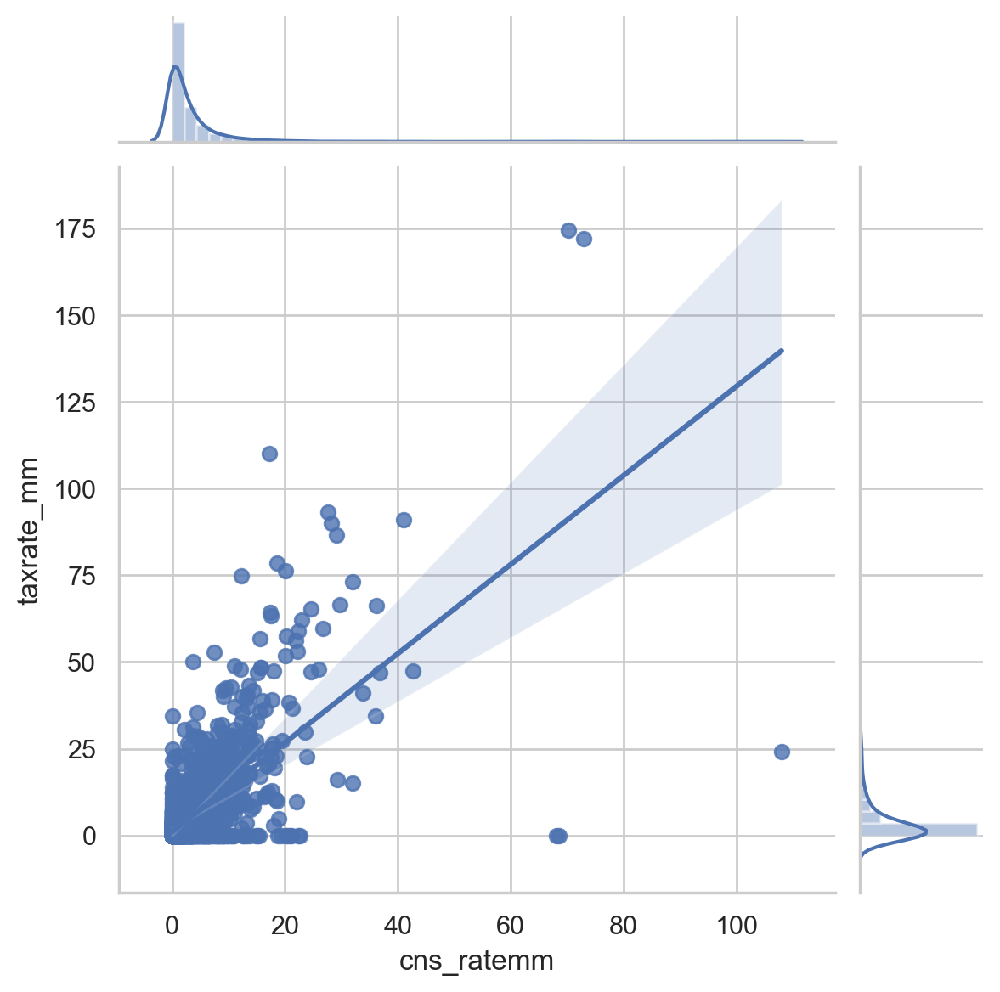

In [53]:
g = sns.JointGrid(x="cns_ratemm", y="taxrate_mm", data=df)
g = g.plot(sns.regplot, sns.distplot)

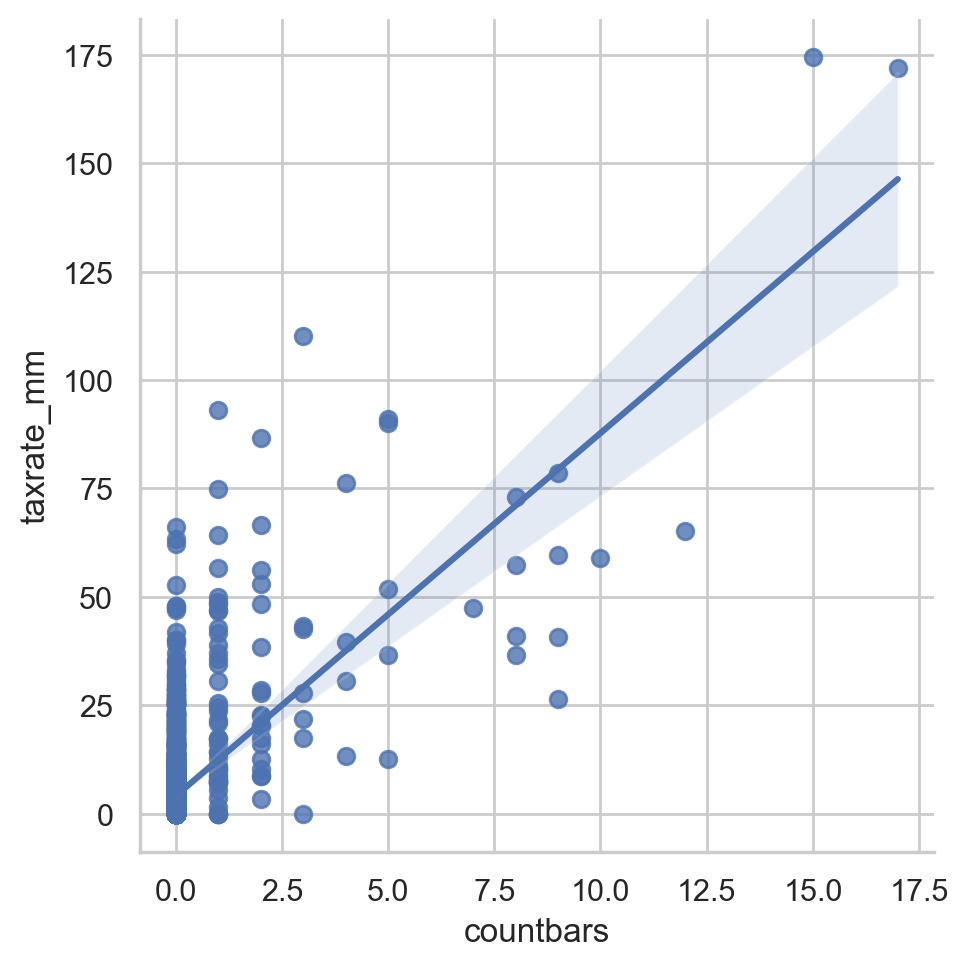

In [54]:
# lmplot allows you to display linear models, but it also conveniently allows you to split up those plots based off of features, as well as coloring the hue based off of features.
sns.lmplot(x='countbars', y='taxrate_mm', data=df_focus, palette='seismic')

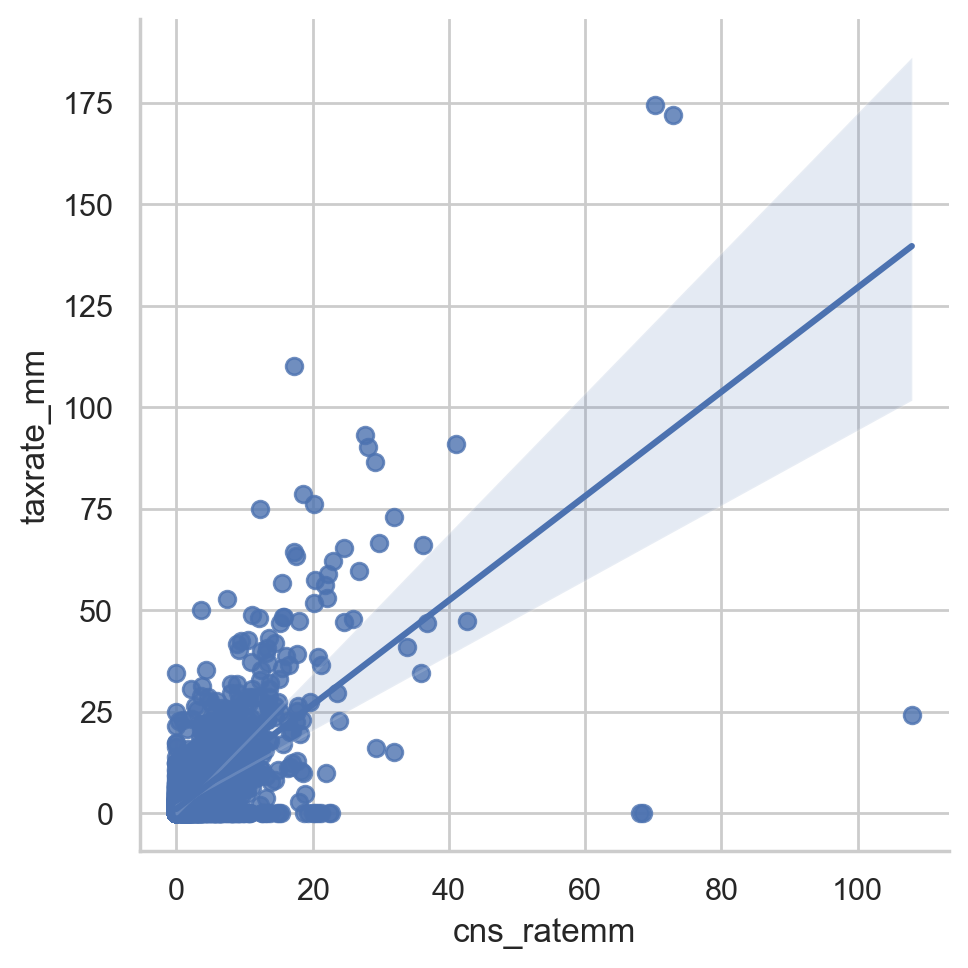

In [55]:
sns.lmplot(x='cns_ratemm',y='taxrate_mm',data=df_focus,palette='coolwarm')

# Step 8: Heatmap for total index with Plotly

In [56]:
!pip install pandas-bokeh
!pip install pgeocode
!pip install geopandas

Loading BokehJS ...

C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\1104683616.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_focus['Latitude'] = (nomi.query_postal_code(df_focus['geoid10'].astype(str).tolist()).latitude)
C:\Users\gongl1\AppData\Local\Temp\ipykernel_22168\1104683616.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_focus['Longitude'] = (nomi.query_postal_code(df_focus['geoid10'].astype(str).tolist()).longitude)


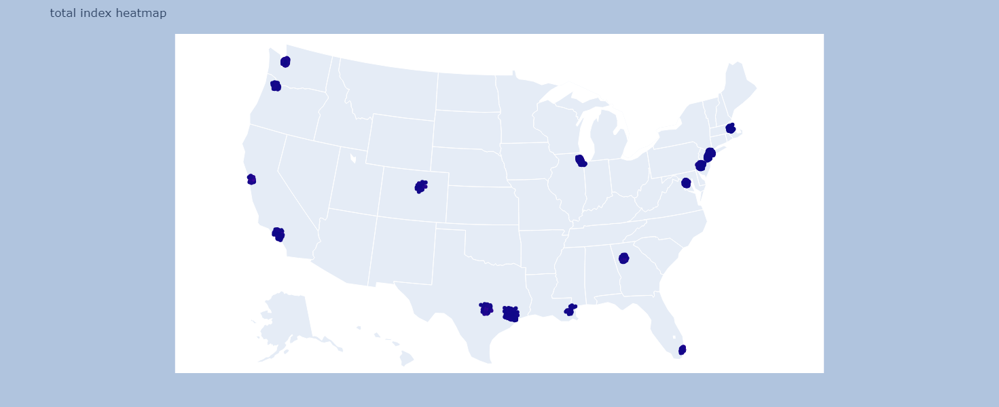

In [57]:
import pandas as pd
import pandas_bokeh
import matplotlib.pyplot as plt
import pgeocode
import geopandas as gpd
from shapely.geometry import Point
from geopandas import GeoDataFrame
pandas_bokeh.output_notebook()
import plotly.graph_objects as go

nomi = pgeocode.Nominatim('us')

# edf = pd.read_csv('myFile.tsv', sep='\t',header=None, index_col=False ,names=['colC','zipcode','count'])
df_focus['Latitude'] = (nomi.query_postal_code(df_focus['geoid10'].astype(str).tolist()).latitude)
df_focus['Longitude'] = (nomi.query_postal_code(df_focus['geoid10'].astype(str).tolist()).longitude)

fig = go.Figure(data=go.Scattergeo(
        lon = df_focus['Longitude'],
        lat = df_focus['Latitude'],
        text = df_focus['geoid10'],
        mode = 'markers',
        marker_color = df_focus['totindex']
        ))

fig.update_layout(
        title = 'total index heatmap',
        geo_scope='usa',
    )


fig.update_layout(
    autosize=False,
    width=1000,
    height=600,
    margin=dict(
        l=50,
        r=50,
        b=50,
        t=50,
        pad=4
    ),
    paper_bgcolor="LightSteelBlue",
)

fig.show()